In [4]:
import torch
import numpy as np
from sklearn.metrics import roc_curve, recall_score, precision_score
import plotly.graph_objects as go
import plotly.io as pio

In [5]:
from analysis_utils import load_loss, predict, plot_roc_auc, generate_plotly_colors, plot_metrics_vs_thresholds, plot_metrics_vs_energy

# Validation generator load

In [6]:
import random

import data.config_manager as cfgm
from data.batch_generator import BatchGenerator

# data
name_of_dataset = "munusep_all_small"
val_paths = cfgm.read_paths(f"/home/albert/Baikal-ML/data/configurations/{name_of_dataset}/val_paths.csv")
random.shuffle(val_paths)
mu_paths = [p for p in val_paths if 'muatm' in p]
nuatm_paths = [p for p in val_paths if 'nuatm' in p]
nue2_paths = [p for p in val_paths if 'nue2' in p]
val_paths = mu_paths[0:16] + nuatm_paths[0:12] + nue2_paths[0:2]

cfg = cfgm.load_cfg(f"/home/albert/Baikal-ML/data/configurations/{name_of_dataset}/val_cfg.yaml")
val_gen = BatchGenerator(val_paths, cfg)

# Load network

In [ ]:
from nnetworks.models.munusep_resnet import MuNuSepResNet
from nnetworks.models.munusep_transformer import TransformerClassifier
from nnetworks.models.config_manager import model_from_yaml

# model
#name = "2024-11-28_17-46-01_MediumResNet_k3-3-3_AvPool_SmallDS_binary_lr1e-4_LayerNorm"
#x name = "2024-11-14_16-09-01_TinyResNet_k3-3-5_SmallDS_binary_lr1e-4_LayerNorm_3target"
name = "2024-11-27_16-11-04_MiddleTransformer_4H_256DM_256DFF_MaxPool_SmallDS_binary_lr1e-4"
model_class = TransformerClassifier

checkpoint = "epoch_2_best_by_test"
model = model_from_yaml(model_class, f"/home/albert/Baikal-ML/experiments/MuNuSepAll/{name}/model_cfg.yaml")
model.load_state_dict(torch.load(f"/home/albert/Baikal-ML/experiments/MuNuSepAll/{name}/checkpoints/{checkpoint}.pt", weights_only=True))

<All keys matched successfully>

In [8]:
# device
device = torch.device("cuda:0")
model.to(device)
model.eval()
print()

# Make predicitons and cache some info about events

In [9]:
loss, result_df = predict(model, val_gen, device, loss_function=load_loss("FocalLoss"))

2024-12-03 20:37:06,436 - INFO - #0 chunk loaded.
2024-12-03 20:37:49,072 - INFO - #1 chunk loaded.
2024-12-03 20:38:29,958 - INFO - #2 chunk loaded.


In [10]:
loss

0.0838505735999322

In [11]:
result_df.head(5)

,y_true,y_pred,num_signal_hits,num_signal_strings,PrimePhi,PrimeTheta,PrimeEn,BundleEnReg,ev_id,cluster_id
0,"[1.0, 0.0]","[0.6097535490989685, 0.3902464509010315]",6,2,288.414795,150.260193,128.474487,1433.318237,muatm_11535_0,1
1,"[1.0, 0.0]","[0.42140766978263855, 0.5785923600196838]",3,2,128.804016,144.306091,0.901887,131.953018,muatm_11535_1,3
2,"[1.0, 0.0]","[0.712928056716919, 0.28707194328308105]",6,3,237.149902,159.812729,14.760383,764.897949,muatm_11535_10,6
3,"[1.0, 0.0]","[0.5810233950614929, 0.41897663474082947]",2,1,54.545166,142.570740,30.097240,515.560547,muatm_11535_100,4
4,"[1.0, 0.0]","[0.4155733287334442, 0.5844267010688782]",3,2,324.186157,123.113068,13.810026,210.892090,muatm_11535_1000,6


# Plot ROC curve and metrics

In [12]:
def get_rates(result_df, mask=None):
    if mask is not None:
        df = result_df[mask]
    else:
        df = result_df
    y_true, y_pred = np.array(df['y_true'].tolist()), np.array(df['y_pred'].tolist())
    # Calculate false positive rate, true positive rate, and threshold
    return roc_curve(y_true[:,1], y_pred[:,1], drop_intermediate=True)

## Metrics VS hits num

In [13]:
#Plot
# Create Plotly figure for ROC AUC curve
fig_roc_curve = go.Figure()
# Update layout
fig_roc_curve.update_layout(
    title='ROC AUC Curve',
    xaxis=dict(title='False Positive Rate'),
    yaxis=dict(title='True Positive Rate'),
    showlegend=True,
    width=800,
    height=600,
     legend=dict(title="Filters")
)

# Create Plotly figure for MetricVsTresholds curves
fig_metrics = go.Figure()
fig_metrics.update_layout(
    title="Recall and Precision vs Thresholds", #'(TPR / Recall / Sensitivity), (1-FPR / Precision / Purity) vs Thresholds',
    xaxis=dict(title='Threshold'),
    yaxis=dict(title='Metric Value'),
    width=800,
    height=600,
    legend=dict(title="Metric")
)

colors = []
smin, smax = 2, np.inf
# Example usage:
num_colors = 10  # Number of colors needed
colors = generate_plotly_colors(num_colors)
for c, (hmin, hmax) in zip(colors, [(0, 5),(5,8),(8,16),(16,np.inf)]):
    mask = (result_df["num_signal_hits"]>=hmin) & (result_df["num_signal_hits"]<hmax) & (result_df["num_signal_strings"]>=smin) & (result_df["num_signal_strings"]<smax)
    fpr, tpr, thresholds = get_rates(result_df, mask=mask)
    fig_roc_curve = plot_roc_auc(fpr, tpr, fig_roc_curve, name=f"ROC curve,<br>{hmin}<=hits<{hmax},<br>{smin}<=strings<{smax},<br>")
    fig_metrics = plot_metrics_vs_thresholds(fpr, tpr, thresholds, fig_metrics, name=f"{hmin}<=hits<{hmax},<br>{smin}<=strings<{smax},<br>", color=c)

# Add a 45-degree line representing random chance
fig_roc_curve.add_trace(go.Scatter(
    x=[0, 1], y=[0, 1], mode='lines', name='Random Chance',
    line=dict(dash='dash', color='gray')
))

fig_roc_curve.show()
fig_metrics.show()

pio.write_html(fig_roc_curve, "ROCCurveByHits.html")
pio.write_html(fig_metrics, "MetricsThresholdByHits.html")

## Metrics VS energy

In [57]:
result_df[result_df['PrimeTheta']<90]['y_true'].value_counts()

y_true
[0.0, 1.0]    419370
Name: count, dtype: int64

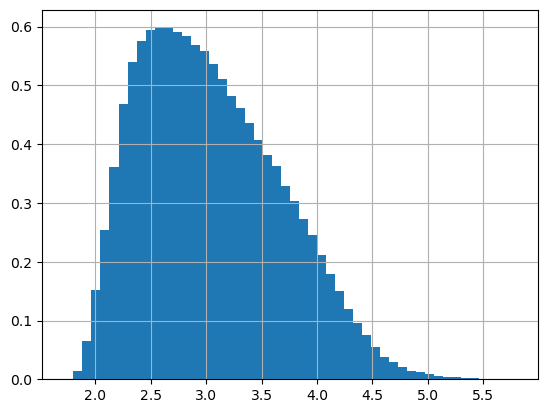

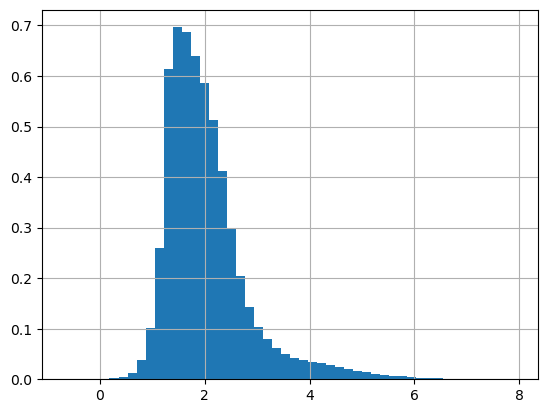

In [15]:
import matplotlib.pyplot as plt
result_df['lgEmu'] = result_df['BundleEnReg'].apply(np.log10)
result_df['lgEmu'][(result_df['PrimeTheta']>90)].hist(bins=50, density=True)
plt.show()
result_df['lgEmu'][(result_df['PrimeTheta']<90)].hist(bins=50, density=True)
plt.show()

In [35]:
#Plot
# Create Plotly figure for ROC AUC curve
fig_roc_curve = go.Figure()
# Update layout
fig_roc_curve.update_layout(
    title='ROC AUC Curve',
    xaxis=dict(title=''), #False Positive Rate
    yaxis=dict(title=''), #True Positive Rate
    showlegend=True,
    width=800,
    height=600,
     legend=dict(title="Legend")
)

# Create Plotly figure for MetricVsTresholds curves
fig_metrics = go.Figure()
fig_metrics.update_layout(
    title="Recall and Precision vs Thresholds", #'(TPR / Recall / Sensitivity), (1-FPR / Precision / Purity) vs Thresholds',
    xaxis=dict(title='Threshold'),
    yaxis=dict(title='Metric Value'),
    width=800,
    height=600,
    legend=dict(title="Metric")
)

colors = []
smin, smax = 2, np.inf
hmin, hmax = 8, np.inf
# Example usage:
num_colors = 10  # Number of colors needed
colors = generate_plotly_colors(num_colors)
Emin, Emax = (0, np.inf) #[(0, 2),(2,3),(3,4),(4,5), (5, np.inf)]
mask = (result_df["num_signal_hits"]>=hmin) & (result_df["num_signal_hits"]<hmax) \
    & (result_df["num_signal_strings"]>=smin) & (result_df["num_signal_strings"]<smax) \
    & (result_df["lgEmu"]>=Emin) & (result_df["lgEmu"]<Emax)
fpr, tpr, thresholds = get_rates(result_df, mask=mask)
fig_roc_curve = plot_roc_auc(fpr, tpr, fig_roc_curve, name=f"ROC curve,<br>hits>={hmin},<br>strings>={smin}<br>")#<br>{Emin}<=lgEmu<{Emax}<br>")
fig_metrics = plot_metrics_vs_thresholds(fpr, tpr, thresholds, fig_metrics, name=f"{Emin}<=lgEmu<{Emax}<br>", color=c)

# Add a 45-degree line representing random chance
fig_roc_curve.add_trace(go.Scatter(
    x=[0, 1], y=[0, 1], mode='lines', name='Random Chance',
    line=dict(dash='dash', color='gray')
))
# Add a 45-degree line representing random chance
fig_roc_curve.add_trace(go.Scatter(
    x=[0, 1], y=[0.99, 0.99], mode='lines', name=r'99% recall',
    line=dict(dash='dash', color='red')
))

point_y = 0.99
point_x = fpr[np.argmin(np.abs(tpr-0.99))]
fig_roc_curve.add_trace(go.Scatter(x=[point_x], y=[point_y], mode='markers', marker=dict(size=10, color='red'), name="Point"))

# Display the rounded coordinates
rounded_x = round(point_x, 2)
rounded_y = round(point_y, 2)
fig_roc_curve.add_annotation(
    x=point_x, 
    y=point_y,
    align='left',
    text=f"({rounded_x}, {rounded_y})",  # Annotation text
    showarrow=True,
    arrowside='end',
    arrowhead=1,
    ax=20,  # Horizontal offset for the text
    ay=20,  # Vertical offset for the text
    font=dict(size=14)
)


# Set default x and y axis limits
fig_roc_curve.update_layout(
    xaxis=dict(range=[0., 0.3], tickfont=dict(size=14), dtick=0.05, showgrid=True),  # Set x-axis range
    yaxis=dict(range=[0.9, 1.], tickfont=dict(size=14), dtick=0.01, showgrid=True),  # Set y-axis range
)
fig_roc_curve.show()
fig_metrics.show()

pio.write_html(fig_roc_curve, "ROCCurveByHits.html")
pio.write_html(fig_metrics, "MetricsThresholdByHits.html")

In [16]:
# Create Plotly figure for MetricVsTresholds curves
fig_metrics = go.Figure()
fig_metrics.update_layout(
    title="Recall and Precision vs Energies", #'(TPR / Recall / Sensitivity), (1-FPR / Precision / Purity) vs Thresholds',
    xaxis=dict(title='lgE'),
    yaxis=dict(title='Metric Value'),
    width=800,
    height=600,
    legend=dict(title="Metric")
)

smin, smax = 2, np.inf
hmin, hmax = 8, np.inf

threshold = 0.286
dE = 0.5
E_points = np.arange(2,6,dE)
recalls, precisions = [[],[]], [[],[]]
for Emin in E_points:
    mask = (result_df["num_signal_hits"]>=hmin) & (result_df["num_signal_hits"]<hmax) \
        & (result_df["num_signal_strings"]>=smin) & (result_df["num_signal_strings"]<smax) \
        & (result_df["lgEmu"]>=Emin) & (result_df["lgEmu"]<Emin+dE)
    fpr, tpr, thresholds = get_rates(result_df, mask=mask)
    assert len(tpr) == len(thresholds)
    i = np.argmin(np.abs(thresholds-threshold))
    recalls[0].append(tpr[i]), precisions[0].append(1-fpr[i])
    recalls[1].append(tpr[i]*1/np.sqrt(mask.sum())), precisions[1].append((1-fpr[i])*1/np.sqrt(mask.sum()))
    
# # Plot TPR vs Threshold
# fig = go.Figure(
#     data=go.Scatter(
#         x=x_labels,
#         y=values,
#         mode='markers+lines',  # Shows both points and connecting lines
#         error_y=dict(
#             type='data',  # Error values are provided in data
#             array=errors,  # Symmetric error values
#             visible=True   # Show error bars
#         ),
#         marker=dict(size=10),  # Customize marker size
#         line=dict(dash='solid')  # Customize line style
#     )
# )


fig_metrics.add_trace(go.Scatter(
    x=E_points+dE/2, y=recalls[0], 
    error_y=dict(type='data', array=recalls[1], visible=True),
    mode='lines', name=f"TPR / Recall / Sensitivity", showlegend=True
))
fig_metrics.add_trace(go.Scatter(
    x=E_points+dE/2, y=precisions[0], 
    error_y=dict(type='data', array=precisions[1], visible=True),
    mode='lines', name=f"FPR / Precision / Purity", showlegend=True
))
fig_metrics.show()
